In [1]:
#!/usr/bin/env python

In [2]:
import numpy as np
from scipy.io import loadmat
import pandas as pd

import matplotlib
matplotlib.use('PDF')
%matplotlib inline
import matplotlib.pyplot as plt

import numpy as np
import math
import codecs
import os
import csv
import scipy 
from scipy import stats
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
import numpy as np
from numpy.random import normal
import pandas as pd


In [3]:
from skimage import color
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import LinearSVC
from sklearn.metrics import classification_report,accuracy_score,confusion_matrix
from sklearn.linear_model import SGDClassifier
from skimage.feature import hog
import colorsys
from sklearn.decomposition import PCA
from sklearn.svm import SVC

In [4]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data.dataloader import DataLoader
from skimage import img_as_ubyte
import pickle

In [5]:
sat = scipy.io.loadmat("sat-4-full.mat")
annotations = sat['annotations']
test_x = sat['test_x']
test_y = sat['test_y']
train_x = sat['train_x']
train_y = sat['train_y']

In [8]:
annotations

array([[array(['1000'], dtype='<U4'),
        array(['barren land'], dtype='<U11')],
       [array(['0100'], dtype='<U4'), array(['trees'], dtype='<U5')],
       [array(['0010'], dtype='<U4'), array(['grassland'], dtype='<U9')],
       [array(['0001'], dtype='<U4'), array(['none'], dtype='<U4')]],
      dtype=object)

[104,103,94,133] is the RGB and NIR values for the first pixel in (0,0) for image 1. Then [175,149,130,146] is the RGB and NIR values for the first pixel in (0,0) for image 2 (imagine image 2 is behind image 1). then starting the next set of four is [114,115,106,145] is the RGB and NIR values for the second pixel (to the right of the first pixel) in (0,1) for the first image. [169,148,130,141] is the RGB and NIR values for the second pixel in (0,1) for the second image. 

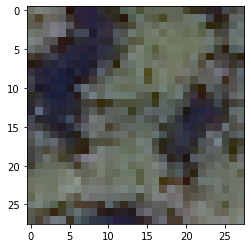

In [9]:
plt.imshow(train_x[: , : , :3 , 2] ) # where i is the test image you want to display.
plt.show()

In [10]:
sample_pic = train_x[: , : , :3 , 2]

In [11]:
train_x.shape

(28, 28, 4, 400000)

In [12]:
# extract label data 

In [6]:
train_y = train_y.transpose()

In [7]:
labels = []
for i in range(len(train_y)):
    check = train_y[i] == [1, 0, 0, 0]
    check1 = train_y[i] == [0, 1, 0, 0]
    check2 = train_y[i] == [0, 0, 1, 0]
    check3 = train_y[i] == [0, 0, 0, 1]
    if all(check) == True:
        labels.append(0)
    elif all(check1) == True:
        labels.append(1)
    elif all(check2) == True:
        labels.append(2)
    else:
        labels.append(3)
labels

[3,
 0,
 1,
 3,
 2,
 0,
 3,
 1,
 0,
 3,
 0,
 1,
 1,
 0,
 3,
 3,
 1,
 2,
 3,
 0,
 3,
 0,
 2,
 0,
 0,
 0,
 0,
 3,
 3,
 0,
 1,
 3,
 0,
 2,
 1,
 3,
 2,
 0,
 0,
 1,
 2,
 3,
 3,
 1,
 3,
 0,
 1,
 0,
 2,
 1,
 1,
 3,
 3,
 3,
 1,
 2,
 3,
 3,
 1,
 0,
 3,
 2,
 1,
 1,
 1,
 0,
 0,
 3,
 1,
 3,
 1,
 0,
 3,
 3,
 0,
 1,
 2,
 3,
 3,
 2,
 2,
 3,
 3,
 3,
 0,
 0,
 3,
 3,
 1,
 3,
 2,
 0,
 0,
 3,
 2,
 0,
 3,
 0,
 3,
 2,
 0,
 3,
 1,
 0,
 3,
 1,
 3,
 3,
 3,
 0,
 0,
 0,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 1,
 0,
 3,
 1,
 1,
 0,
 2,
 0,
 3,
 3,
 3,
 3,
 2,
 3,
 2,
 0,
 2,
 0,
 3,
 3,
 3,
 0,
 2,
 1,
 2,
 0,
 3,
 3,
 1,
 3,
 0,
 0,
 0,
 3,
 3,
 3,
 2,
 0,
 3,
 2,
 3,
 3,
 0,
 1,
 0,
 2,
 1,
 2,
 3,
 1,
 3,
 3,
 3,
 2,
 2,
 0,
 3,
 2,
 3,
 3,
 3,
 2,
 3,
 3,
 0,
 2,
 1,
 3,
 0,
 0,
 1,
 3,
 2,
 1,
 0,
 0,
 3,
 3,
 1,
 3,
 1,
 0,
 3,
 1,
 3,
 3,
 1,
 3,
 1,
 0,
 0,
 0,
 1,
 3,
 3,
 0,
 0,
 1,
 3,
 3,
 1,
 0,
 2,
 1,
 0,
 0,
 3,
 1,
 0,
 3,
 3,
 3,
 3,
 2,
 3,
 3,
 3,
 0,
 1,
 3,
 2,
 3,
 0,
 3,
 1,
 3,
 1,
 3,
 0,
 3,


In [8]:
label_data = np.array(labels).astype('uint8')

In [9]:
test_y = test_y.transpose()

In [10]:
labels_test = []
for i in range(len(test_y)):
    check = test_y[i] == [1, 0, 0, 0]
    check1 = test_y[i] == [0, 1, 0, 0]
    check2 = test_y[i] == [0, 0, 1, 0]
    check3 = test_y[i] == [0, 0, 0, 1]
    if all(check) == True:
        labels_test.append(0)
    elif all(check1) == True:
        labels_test.append(1)
    elif all(check2) == True:
        labels_test.append(2)
    else:
        labels_test.append(3)
labels_test

[0,
 0,
 3,
 2,
 2,
 1,
 0,
 0,
 3,
 0,
 3,
 1,
 1,
 1,
 3,
 0,
 2,
 1,
 3,
 1,
 0,
 3,
 0,
 0,
 1,
 0,
 0,
 3,
 3,
 3,
 0,
 3,
 2,
 1,
 2,
 2,
 3,
 3,
 0,
 0,
 3,
 1,
 3,
 3,
 3,
 2,
 0,
 3,
 0,
 3,
 1,
 2,
 0,
 2,
 1,
 3,
 3,
 3,
 1,
 1,
 0,
 3,
 2,
 2,
 3,
 0,
 3,
 2,
 3,
 3,
 1,
 2,
 3,
 3,
 2,
 1,
 3,
 3,
 1,
 3,
 3,
 1,
 1,
 1,
 3,
 3,
 0,
 0,
 1,
 3,
 1,
 0,
 2,
 3,
 3,
 1,
 0,
 3,
 3,
 3,
 2,
 1,
 0,
 1,
 1,
 3,
 3,
 0,
 3,
 3,
 0,
 0,
 1,
 1,
 1,
 1,
 3,
 3,
 0,
 2,
 2,
 3,
 0,
 1,
 0,
 1,
 1,
 3,
 3,
 0,
 3,
 3,
 3,
 3,
 3,
 0,
 3,
 0,
 0,
 0,
 3,
 3,
 0,
 0,
 3,
 3,
 0,
 0,
 3,
 3,
 1,
 0,
 3,
 1,
 2,
 3,
 3,
 2,
 3,
 3,
 1,
 1,
 1,
 1,
 3,
 0,
 3,
 0,
 0,
 1,
 0,
 1,
 3,
 2,
 3,
 2,
 0,
 3,
 3,
 3,
 2,
 0,
 0,
 3,
 2,
 2,
 0,
 2,
 1,
 3,
 3,
 0,
 3,
 2,
 0,
 1,
 1,
 1,
 1,
 3,
 3,
 1,
 3,
 3,
 3,
 0,
 0,
 3,
 2,
 2,
 3,
 1,
 2,
 0,
 3,
 0,
 1,
 2,
 0,
 1,
 0,
 3,
 2,
 1,
 2,
 2,
 0,
 3,
 3,
 0,
 3,
 1,
 0,
 3,
 3,
 0,
 2,
 0,
 3,
 0,
 1,
 2,
 3,
 2,
 2,
 2,
 3,
 0,
 0,
 2,


In [11]:
label_data_test = np.array(labels_test).astype('uint8')

## Grayscale

In [12]:
# converting all images to greyscale. Output is a list
X_grey = []
for i in range(400000):
    sample_pic = train_x[: , : , :3 ,i]
    X_grey.append(color.rgb2gray(sample_pic))

In [13]:
# Test set
# converting all images to greyscale. Output is a list
X_grey_test = []
for i in range(100000):
    sample_pic = test_x[: , : , :3 ,i]
    X_grey_test.append(color.rgb2gray(sample_pic))

In [14]:
X_grey = np.array(X_grey)

In [15]:
X_grey_test = np.array(X_grey_test)

In [16]:
X_grey_lin = X_grey

In [17]:
X_grey_lin_test = X_grey_test

In [18]:
X_grey_tens = X_grey

In [19]:
X_grey_tens_test = X_grey_test

In [20]:
X_grey = X_grey.reshape(len(X_grey), -1)
X_grey.shape

(400000, 784)

In [ ]:
Xtrain, Xtest, ytrain, ytest = train_test_split(X_grey, label_data, test_size=0.9, random_state=42)

# Normalize

In [ ]:
# normalize 
def normalize(x):
    return (x.astype(float) - 128) / 128

In [ ]:
X_train_norm = normalize(X_grey_lin)

In [ ]:
X_train_norm_lin = np.array(X_train_norm)

## image features and flatten into single row. Here I used the normalized data along with it being converted to hsv and flattened it

In [32]:
X_train_norm_lin.shape

(400000, 28, 28)

In [ ]:
def create_features(img):
    color_features = img.flatten()
    return color_features

In [ ]:
def create_feature_matrix(label_dataframe):
    features_list = []
    for img_id in range(len(label_dataframe)):
        # get features for image
        image_features = create_features(label_dataframe[img_id,:,:])
        features_list.append(image_features)
        
    # convert list of arrays into a matrix
    feature_matrix = np.array(features_list)
    return feature_matrix

# run create_feature_matrix on our dataframe of images
feature_matrix = create_feature_matrix(X_train_norm_lin)

In [ ]:
# get shape of feature matrix
print('Feature matrix shape is: ', feature_matrix.shape)

In [ ]:
X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(feature_matrix,label_data,test_size=.1,random_state=45)

In [37]:
X_train_pca.shape

(360000, 784)

In [ ]:
# Make an instance of the Model
scaler = StandardScaler()
scaler.fit(X_train_pca)

# Apply transform to both the training set and the test set.
train_img = scaler.transform(X_train_pca)
test_img = scaler.transform(X_test_pca)

pca = PCA(.95)
# use fit_transform to run PCA on our standardized matrix
pca.fit(train_img)
train_img = pca.transform(train_img)
test_img = pca.transform(test_img)
# look at new shape
print('PCA matrix shape is: ', train_img.shape)

In [ ]:
# look at the distrubution of labels in the train set
df = pd.Series(y_train_pca).value_counts()
ax = df.plot.bar(x='labels', y='Frequency', rot=0, title="Distrubution of labels in the train set")
ax.set_ylim(0,200000)
ax.set_xlabel("Label")
ax.set_ylabel("Frequency")
ax.set_xticklabels(np.array(["none","barren land","trees","grassland"]))

# PyTorch

### using gray scale values

Reference: https://medium.com/dsnet/image-classification-using-logistic-regression-in-pytorch-ebb96cc9eb79
The image is now converted to a 1x28x28 tensor. The first dimension is used to keep track of the color channels. Since images in the MNIST dataset are grayscale, there’s just one channel. Other datasets have images with color, in which case there are 3 channels: red, green and blue (RGB). Let’s look at some sample values inside the tensor:


## concat dataset with label

In [26]:
len(X_grey_tens)

400000

In [27]:
X_grey_tens.shape

(400000, 28, 28)

In [115]:
X_grey_tens = img_as_ubyte(X_grey_tens)
X_grey_tens

array([[[103, 114, 108, ...,  98, 132, 113],
        [103, 111,  95, ..., 166, 113, 104],
        [ 94, 100, 105, ..., 207, 101, 106],
        ...,
        [104,  93, 110, ..., 151,  89, 101],
        [ 98,  97, 101, ..., 122, 103, 104],
        [ 97,  97, 106, ..., 105, 102, 108]],

       [[153, 151, 144, ..., 164, 144, 144],
        [155, 146, 144, ..., 168, 151, 150],
        [148, 145, 147, ..., 162, 150, 158],
        ...,
        [101,  94,  94, ..., 158, 154, 142],
        [125, 107,  99, ..., 137, 135, 134],
        [150, 124, 118, ..., 123, 133, 129]],

       [[113, 130, 123, ...,  73,  67,  84],
        [ 94,  68, 103, ...,  40,  97, 101],
        [ 94,  90, 110, ...,  56,  91, 116],
        ...,
        [118, 128, 112, ...,  83, 113, 119],
        [ 89,  78,  69, ..., 100, 122, 130],
        [ 87,  67,  91, ..., 131, 124, 134]],

       ...,

       [[115, 116, 119, ..., 118, 115, 123],
        [117, 121, 120, ..., 132, 123, 121],
        [121, 122, 119, ..., 115, 117, 118

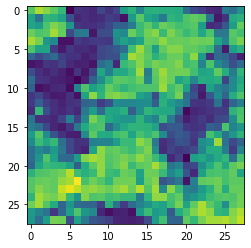

In [29]:
plt.imshow(X_grey_tens[2])

In [116]:
train_transform = transforms.Compose([
        transforms.ToTensor()
    ])
test_transform = transforms.Compose([
        transforms.ToTensor()
    ])

In [117]:
dataset = []
for i in range(400000):
    sample = X_grey_tens[i,:,:]
    trainset = train_transform(sample)
    dataset.append(trainset)
dataset

[tensor([[[0.4039, 0.4471, 0.4235, 0.3765, 0.3961, 0.4275, 0.5490, 0.3608,
           0.3804, 0.3569, 0.3843, 0.4157, 0.4314, 0.3725, 0.4000, 0.4118,
           0.4706, 0.4157, 0.4392, 0.3922, 0.3804, 0.4314, 0.4431, 0.4235,
           0.4471, 0.3843, 0.5176, 0.4431],
          [0.4039, 0.4353, 0.3725, 0.3765, 0.3608, 0.5098, 0.8471, 0.3725,
           0.4353, 0.3804, 0.3569, 0.4824, 0.4745, 0.3765, 0.3686, 0.4235,
           0.6157, 0.4118, 0.4745, 0.4980, 0.3804, 0.4784, 0.4824, 0.4392,
           0.4510, 0.6510, 0.4431, 0.4078],
          [0.3686, 0.3922, 0.4118, 0.3647, 0.4392, 0.4353, 0.4745, 0.4431,
           0.3725, 0.3961, 0.3804, 0.4196, 0.3725, 0.3843, 0.4235, 0.4118,
           0.3843, 0.4314, 0.5765, 0.4824, 0.3882, 0.3804, 0.4000, 0.4196,
           0.4824, 0.8118, 0.3961, 0.4157],
          [0.4039, 0.6667, 0.4000, 0.3804, 0.3961, 0.4353, 0.4784, 0.4549,
           0.2980, 0.3765, 0.4157, 0.3843, 0.4510, 0.4196, 0.3843, 0.3882,
           0.4863, 0.4235, 0.4431, 0.8902, 

In [118]:
label_tensor = []
for img in range(len(dataset)):
    label_tensor.append((dataset[img], labels[img]))

In [119]:
img_tensor, label = label_tensor[0]
print(img_tensor.shape,label)

torch.Size([1, 28, 28]) 3


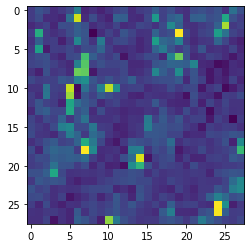

In [34]:
plt.imshow(img_tensor[0])

## randomly pick a fraction of the images for the validation set

In [120]:
def indices_split(n,valset):
    n_val = int(valset*n)
    index = np.random.permutation(n)
    return index[n_val:], index[:n_val]

In [121]:
train_in, val_in = indices_split(len(label_tensor),.2)

In [37]:
len(train_in)

320000

In [122]:
batch = 100
train_sample = SubsetRandomSampler(train_in)
train_load = DataLoader(label_tensor,batch,sampler=train_sample)
val_sample = SubsetRandomSampler(val_in)
val_load = DataLoader(label_tensor,batch,sampler = val_sample)

In [123]:
input_size = 28*28
num_classes = 4
#Logistic Regression model
lin_model = nn.Linear(input_size,num_classes)

In [124]:
print(lin_model.weight.shape)
lin_model.weight

torch.Size([4, 784])


Parameter containing:
tensor([[ 0.0120, -0.0298,  0.0259,  ..., -0.0205, -0.0295, -0.0013],
        [ 0.0341, -0.0143,  0.0028,  ...,  0.0284,  0.0074,  0.0104],
        [ 0.0294,  0.0215, -0.0120,  ...,  0.0019,  0.0315,  0.0294],
        [-0.0199,  0.0275, -0.0103,  ...,  0.0239, -0.0354,  0.0192]],
       requires_grad=True)

In [125]:
print(lin_model.bias.shape)
lin_model.bias

torch.Size([4])


Parameter containing:
tensor([-0.0298,  0.0144, -0.0111, -0.0020], requires_grad=True)

In [126]:
# flatten the model to be a vector of size 784
class MnistModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.linear = nn.Linear(input_size,num_classes)
        
    def forward(self,xb):
        xb = xb.reshape(-1,784)
        out = self.linear(xb)
        return out

In [127]:
lin_model = MnistModel()

In [128]:
print(lin_model.linear.weight.shape,lin_model.linear.bias.shape)
list(lin_model.parameters())

torch.Size([4, 784]) torch.Size([4])


[Parameter containing:
 tensor([[ 0.0016,  0.0254, -0.0241,  ...,  0.0141, -0.0250,  0.0170],
         [ 0.0080, -0.0302, -0.0231,  ..., -0.0257,  0.0214, -0.0288],
         [-0.0086,  0.0028, -0.0187,  ..., -0.0218, -0.0320, -0.0193],
         [ 0.0268, -0.0216,  0.0198,  ..., -0.0260, -0.0206, -0.0061]],
        requires_grad=True), Parameter containing:
 tensor([-0.0072, -0.0174, -0.0310,  0.0235], requires_grad=True)]

In [129]:
for i,label in train_load:
    output = lin_model(i)
    break
print('output.shape:',output.shape)
print('Sample Outputs :\n',output[:2].data)

output.shape: torch.Size([100, 4])
Sample Outputs :
 tensor([[ 0.0220,  0.1872, -0.2637, -0.0162],
        [ 0.0083,  0.1579, -0.3560, -0.0499]])


In [130]:
#change to probabilites and cumulate to 1
prob = F.softmax(output,dim=1)
#sample prob
print("Sample probabilites:\n", prob[:2].data)

Sample probabilites:
 tensor([[0.2568, 0.3030, 0.1930, 0.2472],
        [0.2632, 0.3057, 0.1828, 0.2483]])


In [131]:
#classify each image by choosing the index of the element with the highest probability in each output row. 
max_prob, pred = torch.max(prob,dim=1)
print(pred)

tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 0, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
        1, 1, 1, 1])


In [132]:
label

tensor([3, 0, 1, 0, 3, 0, 1, 0, 3, 1, 0, 1, 2, 0, 1, 1, 1, 1, 3, 2, 0, 3, 3, 2,
        0, 1, 1, 2, 1, 3, 3, 2, 0, 1, 0, 3, 3, 2, 3, 2, 0, 0, 3, 3, 3, 3, 1, 0,
        2, 0, 3, 1, 0, 1, 1, 0, 3, 1, 1, 1, 2, 1, 1, 1, 2, 0, 0, 0, 2, 2, 1, 0,
        0, 2, 3, 1, 3, 0, 3, 1, 3, 2, 0, 3, 1, 3, 2, 3, 0, 0, 3, 3, 3, 3, 1, 0,
        1, 0, 1, 3])

# Evaluate

In [133]:
def accuracy(first,second):
    return torch.sum(first==second).item()/len(first)

In [136]:
accuracy(pred,label)

0.26

In [137]:
loss_f = F.cross_entropy
loss = loss_f(output,label)
print(loss)

tensor(1.3701, grad_fn=<NllLossBackward>)


## Optimize
update the weights and biases during training, but with a higher learning rate of 1e-3

In [40]:
learn_rate = .001
optimize = torch.optim.SGD(lin_model.parameters(),lr=learn_rate)

## Train Model

In [138]:
def loss_batch(model,loss_func,xb,yb,opt=None,metric=None):
        pred = model(xb)
        loss = loss_func(pred,yb)
        
        if opt is not None:
            loss.backward()
            opt.step()
            opt.zero_grad()
        metric_result = None
        if metric is not None:
            metric_result = metric(pred,yb)
        
        return loss.item(),len(xb),metric_result

In [139]:
def evaluate(model, loss_f, valid_dl, metric = None):
    with torch.no_grad():
        results = [loss_batch(model,loss_f, xb,yb,metric=metric) for xb,yb in valid_dl]
        losses,nums,metrics = zip(*results)
        total = np.sum(nums)
        total_loss = np.sum(np.multiply(losses,nums))
        avg_loss = total_loss/total
        avg_metric = None
        if metric is not None:
            tot_metric= np.sum(np.multiply(metrics,nums))
            avg_metric = tot_metric/total
    return avg_loss,total,avg_metric

In [140]:
def accuracy(output,label):
    _,pred = torch.max(output,dim=1)
    return torch.sum(pred == label).item() /len(pred)


In [86]:
val_loss,total,val_acc=evaluate(lin_model,loss_f,val_load,metric=accuracy)
print('Loss: {:.4f},Accuracy: {:.4f}'.format(val_loss,val_acc))

Loss: 1.0183,Accuracy: 0.6058


In [141]:
def fit(epoch,model,loss_f,opt,train_dl,valid_dl,metric=None):
    for epoc in range(epoch):
        for xb,yb in train_dl:
            loss,_,_ = loss_batch(model,loss_f,xb,yb,opt)
            
        result = evaluate(model,loss_f,valid_dl,metric)
        valid_loss,total,val_metric = result
        
        if metric is None:
            print('Epoch [{}/{}],Loss: {:.4f}'.format(epoc+1,epoch,val_loss))
        else:
            print('Epoch [{}/{}],Loss: {:.4f},{}:{:.4f}'.format(epoc+1,epoch,val_loss,metric.__name__,val_metric))

We are now ready to train the model. Let’s train for 5 epochs and look at the results.

In [49]:
lin_model = MnistModel()
optimize = torch.optim.SGD(lin_model.parameters(),lr=learn_rate)

In [52]:
fit(5,lin_model,F.cross_entropy,optimize,train_load,val_load,accuracy)

Epoch [1/5],Loss: 1.3801,accuracy:0.5086
Epoch [2/5],Loss: 1.3801,accuracy:0.5190
Epoch [3/5],Loss: 1.3801,accuracy:0.5249
Epoch [4/5],Loss: 1.3801,accuracy:0.5085
Epoch [5/5],Loss: 1.3801,accuracy:0.5324


With just 5 epochs of training, our model has reached an accuracy of over 50% on the validation set. Let’s see if we can improve that by training for a few more epochs.

In [105]:
fit(20,lin_model,F.cross_entropy,optimize,train_load,val_load,accuracy)

Epoch [1/20],Loss: 1.0183,accuracy:0.6044
Epoch [2/20],Loss: 1.0183,accuracy:0.5965
Epoch [3/20],Loss: 1.0183,accuracy:0.5982
Epoch [4/20],Loss: 1.0183,accuracy:0.5935
Epoch [5/20],Loss: 1.0183,accuracy:0.5998
Epoch [6/20],Loss: 1.0183,accuracy:0.6025
Epoch [7/20],Loss: 1.0183,accuracy:0.6111
Epoch [8/20],Loss: 1.0183,accuracy:0.6045
Epoch [9/20],Loss: 1.0183,accuracy:0.6126
Epoch [10/20],Loss: 1.0183,accuracy:0.6012
Epoch [11/20],Loss: 1.0183,accuracy:0.5987
Epoch [12/20],Loss: 1.0183,accuracy:0.6024
Epoch [13/20],Loss: 1.0183,accuracy:0.6090
Epoch [14/20],Loss: 1.0183,accuracy:0.6030
Epoch [15/20],Loss: 1.0183,accuracy:0.6092
Epoch [16/20],Loss: 1.0183,accuracy:0.6076
Epoch [17/20],Loss: 1.0183,accuracy:0.6050
Epoch [18/20],Loss: 1.0183,accuracy:0.6144
Epoch [19/20],Loss: 1.0183,accuracy:0.6059
Epoch [20/20],Loss: 1.0183,accuracy:0.6120


Text(0.5, 1.0, 'Accuracy of classifier over number of epochs')

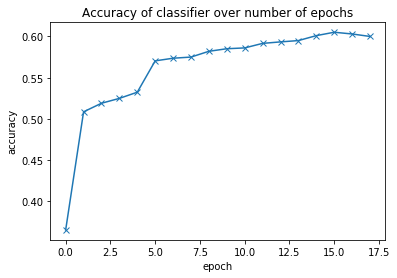

In [56]:
accuracy = [0.3654,0.5086,.5190,.5249,.5324,.5704,.5736,.5750,.5820,.5851,.5861,.5916,.5934,.5950,.6010,.6051,.6030,.60]
plt.plot(accuracy,'-x')
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.title("Accuracy of classifier over number of epochs")


## Test

In [72]:
X_grey_tens_test = img_as_ubyte(X_grey_tens_test)

In [73]:
dataset_test = []
for i in range(100000):
    sample = X_grey_tens_test[i,:,:]
    testset = train_transform(sample)
    dataset_test.append(testset)
dataset_test

[tensor([[[0.4784, 0.5255, 0.4980, 0.5333, 0.5137, 0.4824, 0.4902, 0.5451,
           0.4902, 0.4863, 0.5412, 0.4980, 0.4941, 0.4627, 0.4471, 0.5490,
           0.6078, 0.5725, 0.5451, 0.5490, 0.5098, 0.5529, 0.5882, 0.5294,
           0.5608, 0.5176, 0.5255, 0.5059],
          [0.4941, 0.5216, 0.4863, 0.5098, 0.5098, 0.5098, 0.5176, 0.5059,
           0.4667, 0.5176, 0.4824, 0.5137, 0.5412, 0.4706, 0.4627, 0.4902,
           0.5255, 0.5765, 0.5255, 0.5529, 0.4824, 0.5098, 0.5843, 0.6078,
           0.6157, 0.5216, 0.5255, 0.5294],
          [0.5216, 0.5216, 0.4941, 0.5020, 0.4941, 0.5725, 0.5137, 0.5059,
           0.4824, 0.5255, 0.5059, 0.5098, 0.5020, 0.4824, 0.4627, 0.4902,
           0.5098, 0.5451, 0.4824, 0.5333, 0.5059, 0.6431, 0.5490, 0.5686,
           0.5765, 0.5608, 0.5059, 0.5333],
          [0.5529, 0.5294, 0.5137, 0.4863, 0.4941, 0.5255, 0.5098, 0.5020,
           0.5059, 0.5137, 0.5137, 0.4941, 0.4627, 0.4784, 0.4784, 0.4353,
           0.4902, 0.5569, 0.4863, 0.5412, 

In [74]:
label_tensor_test = []
for img in range(len(dataset_test)):
    label_tensor_test.append((dataset_test[img], labels_test[img]))
label_tensor_test

[(tensor([[[0.4784, 0.5255, 0.4980, 0.5333, 0.5137, 0.4824, 0.4902, 0.5451,
            0.4902, 0.4863, 0.5412, 0.4980, 0.4941, 0.4627, 0.4471, 0.5490,
            0.6078, 0.5725, 0.5451, 0.5490, 0.5098, 0.5529, 0.5882, 0.5294,
            0.5608, 0.5176, 0.5255, 0.5059],
           [0.4941, 0.5216, 0.4863, 0.5098, 0.5098, 0.5098, 0.5176, 0.5059,
            0.4667, 0.5176, 0.4824, 0.5137, 0.5412, 0.4706, 0.4627, 0.4902,
            0.5255, 0.5765, 0.5255, 0.5529, 0.4824, 0.5098, 0.5843, 0.6078,
            0.6157, 0.5216, 0.5255, 0.5294],
           [0.5216, 0.5216, 0.4941, 0.5020, 0.4941, 0.5725, 0.5137, 0.5059,
            0.4824, 0.5255, 0.5059, 0.5098, 0.5020, 0.4824, 0.4627, 0.4902,
            0.5098, 0.5451, 0.4824, 0.5333, 0.5059, 0.6431, 0.5490, 0.5686,
            0.5765, 0.5608, 0.5059, 0.5333],
           [0.5529, 0.5294, 0.5137, 0.4863, 0.4941, 0.5255, 0.5098, 0.5020,
            0.5059, 0.5137, 0.5137, 0.4941, 0.4627, 0.4784, 0.4784, 0.4353,
            0.4902, 0.5569, 0

In [87]:
test_load = DataLoader(label_tensor_test,batch_size=200)
test_loss,total,test_acc= evaluate(lin_model,loss_f,test_load,metric = accuracy)
print('Loss: {:.4f},Accuracy: {:.4f}'.format(test_loss,test_acc))

Loss: 1.0167,Accuracy: 0.6088


In [142]:
def predict_image(img,model):
    xb = img.unsqueeze(0)
    yb = model(xb)
    _,pred = torch.max(yb,dim=1)
    return pred[0].item()


shape: torch.Size([1, 28, 28])
Label: 3 ,Predicted: 3


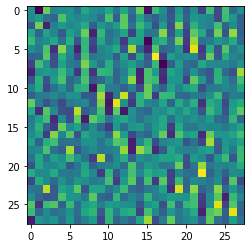

In [101]:
# test individual
img, label = label_tensor_test[10]
plt.imshow(img[0])
print('shape:',img.shape)
print('Label:',label,',Predicted:',predict_image(img,lin_model))

In [102]:
torch.save(lin_model.state_dict(),'tensorclass.pth')

In [103]:
lin_model.state_dict()

OrderedDict([('linear.weight',
              tensor([[ 0.0938,  0.0917,  0.0167,  ...,  0.0238,  0.0533,  0.0759],
                      [-0.0204, -0.0182, -0.0295,  ..., -0.0567, -0.0672, -0.0194],
                      [-0.0295,  0.0076, -0.0030,  ..., -0.0372,  0.0016, -0.0319],
                      [ 0.0090, -0.0348, -0.0197,  ..., -0.0360, -0.0190, -0.0617]])),
             ('linear.bias', tensor([-5.3185,  4.3374,  0.3543,  0.7172]))])

In [104]:
model1=MnistModel()
model1.load_state_dict(torch.load('tensorclass.pth'))
model1.state_dict()

OrderedDict([('linear.weight',
              tensor([[ 0.0938,  0.0917,  0.0167,  ...,  0.0238,  0.0533,  0.0759],
                      [-0.0204, -0.0182, -0.0295,  ..., -0.0567, -0.0672, -0.0194],
                      [-0.0295,  0.0076, -0.0030,  ..., -0.0372,  0.0016, -0.0319],
                      [ 0.0090, -0.0348, -0.0197,  ..., -0.0360, -0.0190, -0.0617]])),
             ('linear.bias', tensor([-5.3185,  4.3374,  0.3543,  0.7172]))])

In [ ]:
test_load = DataLoader(label_tensor_test,batch_size=200)
test_loss,total,test_acc= evaluate(lin_model,loss_f,test_load,metric = accuracy)
print('Loss: {:.4f},Accuracy: {:.4f}'.format(test_loss,test_acc))

## Optimize PyTorch

In [176]:
learn_rate = .05
optimize = torch.optim.SGD(lin_model.parameters(),lr=learn_rate)

In [177]:
val_loss,total,val_acc=evaluate(lin_model,loss_f,val_load,metric=accuracy)
print('Loss: {:.4f},Accuracy: {:.4f}'.format(val_loss,val_acc))

Loss: 2.3222,Accuracy: 0.3951


In [178]:
lin_model = MnistModel()
optimize = torch.optim.SGD(lin_model.parameters(),lr=learn_rate)

In [179]:
fit(5,lin_model,F.cross_entropy,optimize,train_load,val_load,accuracy)

Epoch [1/5],Loss: 2.3222,accuracy:0.5501
Epoch [2/5],Loss: 2.3222,accuracy:0.5688
Epoch [3/5],Loss: 2.3222,accuracy:0.4399
Epoch [4/5],Loss: 2.3222,accuracy:0.6422
Epoch [5/5],Loss: 2.3222,accuracy:0.6450


In [180]:
fit(5,lin_model,F.cross_entropy,optimize,train_load,val_load,accuracy)

Epoch [1/5],Loss: 2.3222,accuracy:0.6246
Epoch [2/5],Loss: 2.3222,accuracy:0.5326
Epoch [3/5],Loss: 2.3222,accuracy:0.5835
Epoch [4/5],Loss: 2.3222,accuracy:0.4737
Epoch [5/5],Loss: 2.3222,accuracy:0.4692


In [181]:
fit(5,lin_model,F.cross_entropy,optimize,train_load,val_load,accuracy)

Epoch [1/5],Loss: 2.3222,accuracy:0.5056
Epoch [2/5],Loss: 2.3222,accuracy:0.5775
Epoch [3/5],Loss: 2.3222,accuracy:0.5885
Epoch [4/5],Loss: 2.3222,accuracy:0.6215
Epoch [5/5],Loss: 2.3222,accuracy:0.6384


In [182]:
fit(15,lin_model,F.cross_entropy,optimize,train_load,val_load,accuracy)

Epoch [1/15],Loss: 2.3222,accuracy:0.6477
Epoch [2/15],Loss: 2.3222,accuracy:0.5707
Epoch [3/15],Loss: 2.3222,accuracy:0.4979
Epoch [4/15],Loss: 2.3222,accuracy:0.6495
Epoch [5/15],Loss: 2.3222,accuracy:0.5196
Epoch [6/15],Loss: 2.3222,accuracy:0.4507
Epoch [7/15],Loss: 2.3222,accuracy:0.5366
Epoch [8/15],Loss: 2.3222,accuracy:0.3928
Epoch [9/15],Loss: 2.3222,accuracy:0.6464
Epoch [10/15],Loss: 2.3222,accuracy:0.4950
Epoch [11/15],Loss: 2.3222,accuracy:0.6094
Epoch [12/15],Loss: 2.3222,accuracy:0.5850
Epoch [13/15],Loss: 2.3222,accuracy:0.6129
Epoch [14/15],Loss: 2.3222,accuracy:0.5300
Epoch [15/15],Loss: 2.3222,accuracy:0.6471


Text(0.5, 1.0, 'Accuracy of classifier over number of epochs')

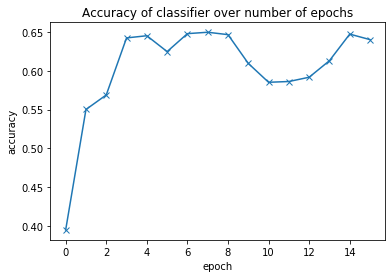

In [200]:
accuracy = [0.3951,0.5501,.5688,.6422,.6450,.6246,.6477,.6495,
            .6464,.6094,.5851,.5861,.5916,
            .6129,.6471,.6400]
plt.plot(accuracy,'-x')
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.title("Accuracy of classifier over number of epochs")

In [183]:
X_grey_tens_test = img_as_ubyte(X_grey_tens_test)

In [184]:
dataset_test = []
for i in range(100000):
    sample = X_grey_tens_test[i,:,:]
    testset = train_transform(sample)
    dataset_test.append(testset)

In [185]:
label_tensor_test = []
for img in range(len(dataset_test)):
    label_tensor_test.append((dataset_test[img], labels_test[img]))

In [186]:
test_load = DataLoader(label_tensor_test,batch_size=200)
test_loss,total,test_acc= evaluate(lin_model,loss_f,test_load,metric = accuracy)
print('Loss: {:.4f},Accuracy: {:.4f}'.format(test_loss,test_acc))

Loss: 1.0051,Accuracy: 0.6479


## SVM Classifier

In [33]:
svc_clf = Pipeline([('scaler', StandardScaler()),('svc', SVC())])

In [34]:
svc_clf.fit(Xtrain, ytrain)

Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('svc',
                 SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None,
                     coef0=0.0, decision_function_shape='ovr', degree=3,
                     gamma='scale', kernel='rbf', max_iter=-1,
                     probability=False, random_state=None, shrinking=True,
                     tol=0.001, verbose=False))],
         verbose=False)

In [35]:
svc_clf.get_params

<bound method Pipeline.get_params of Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('svc',
                 SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None,
                     coef0=0.0, decision_function_shape='ovr', degree=3,
                     gamma='scale', kernel='rbf', max_iter=-1,
                     probability=False, random_state=None, shrinking=True,
                     tol=0.001, verbose=False))],
         verbose=False)>

In [36]:
ypred = svc_clf.predict(Xtest)

print("Accuracy: "+str(accuracy_score(ytest, ypred)))
print('\n')
print(classification_report(ytest, ypred))

Accuracy: 0.8330888888888889


              precision    recall  f1-score   support

           0       0.86      0.86      0.86     94073
           1       0.86      0.87      0.87     73124
           2       0.75      0.69      0.72     64596
           3       0.83      0.86      0.85    128207

    accuracy                           0.83    360000
   macro avg       0.83      0.82      0.82    360000
weighted avg       0.83      0.83      0.83    360000



In [ ]:
# save the model to disk
filename = 'model.dat'
pickle.dump(svc_clf, open(filename, 'wb'))

## Break

## Break

In [ ]:
svc_clf2 = Pipeline([('scaler', StandardScaler()),('svc', SVC())])
svc_clf2.fit(train_img, y_train_pca)

In [ ]:
svc_clf2.get_params

In [ ]:
ypred = svc_clf2.predict(test_img)

print("Accuracy: "+str(accuracy_score(y_test_pca, ypred)))
print('\n')
print(classification_report(y_test_pca, ypred))

In [ ]:
train_img

## Linear SVC

Because the implementations are different in practice you will get different results, the most important ones being that LinearSVC only supports a linear kernel, is faster and can scale a lot better.

In [166]:
Xtrain.shape

(40000, 784)

In [26]:
linearsvc_clf = Pipeline([
    ('scaler', StandardScaler()),
    ('linear_svc', LinearSVC(loss='hinge'))
])
linearsvc_clf.fit(Xtrain, ytrain)

/Applications/anaconda/envs/torch/lib/python3.7/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('linear_svc',
                 LinearSVC(C=1.0, class_weight=None, dual=True,
                           fit_intercept=True, intercept_scaling=1,
                           loss='hinge', max_iter=1000, multi_class='ovr',
                           penalty='l2', random_state=None, tol=0.0001,
                           verbose=0))],
         verbose=False)

In [27]:
ypred = linearsvc_clf.predict(Xtest)

print("Accuracy: "+str(accuracy_score(ytest, ypred)))
print('\n')
print(classification_report(ytest, ypred))

Accuracy: 0.5330222222222222


              precision    recall  f1-score   support

           0       0.66      0.91      0.76     94073
           1       0.51      0.80      0.62     73124
           2       0.20      0.11      0.14     64596
           3       0.52      0.32      0.40    128207

    accuracy                           0.53    360000
   macro avg       0.47      0.53      0.48    360000
weighted avg       0.49      0.53      0.49    360000



In [192]:
linearsvc_clf2 = Pipeline([
    ('scaler', StandardScaler()),
    ('linear_svc', LinearSVC(loss='hinge'))
])
linearsvc_clf2.fit(train_img, y_train_pca)

/Applications/anaconda/envs/torch/lib/python3.7/site-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('linear_svc',
                 LinearSVC(C=1.0, class_weight=None, dual=True,
                           fit_intercept=True, intercept_scaling=1,
                           loss='hinge', max_iter=1000, multi_class='ovr',
                           penalty='l2', random_state=None, tol=0.0001,
                           verbose=0))],
         verbose=False)

In [195]:
ypred2 = linearsvc_clf2.predict(test_img)

print("Accuracy: "+str(confusion_matrix(y_test_pca, ypred2)))
print('\n')
print(classification_report(y_test_pca, ypred2))

Accuracy: [[10125    82    98    70]
 [   34  7511   302   299]
 [ 3087  2201   986   952]
 [ 3153  5250  2883  2967]]


              precision    recall  f1-score   support

           0       0.62      0.98      0.76     10375
           1       0.50      0.92      0.65      8146
           2       0.23      0.14      0.17      7226
           3       0.69      0.21      0.32     14253

    accuracy                           0.54     40000
   macro avg       0.51      0.56      0.47     40000
weighted avg       0.55      0.54      0.47     40000



## SGD 

In [41]:
sgd_clf = Pipeline([
    ('scaler', StandardScaler()),
    ('sgd_clf', SGDClassifier())
])

sgd_clf.fit(Xtrain, ytrain)

Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('sgd_clf',
                 SGDClassifier(alpha=0.0001, average=False, class_weight=None,
                               early_stopping=False, epsilon=0.1, eta0=0.0,
                               fit_intercept=True, l1_ratio=0.15,
                               learning_rate='optimal', loss='hinge',
                               max_iter=1000, n_iter_no_change=5, n_jobs=None,
                               penalty='l2', power_t=0.5, random_state=None,
                               shuffle=True, tol=0.001, validation_fraction=0.1,
                               verbose=0, warm_start=False))],
         verbose=False)

In [42]:
ypred = sgd_clf.predict(Xtest)

print("Accuracy: "+str(accuracy_score(ytest, ypred)))
print('\n')
print(classification_report(ytest, ypred))

Accuracy: 0.5177916666666667


              precision    recall  f1-score   support

           0       0.66      0.96      0.78     94073
           1       0.53      0.56      0.55     73124
           2       0.15      0.15      0.15     64596
           3       0.55      0.35      0.43    128207

    accuracy                           0.52    360000
   macro avg       0.47      0.51      0.48    360000
weighted avg       0.51      0.52      0.50    360000



## Break

In [43]:
sgd_clf = Pipeline([
    ('scaler', StandardScaler()),
    ('sgd_clf', SGDClassifier())
])

sgd_clf.fit(train_img, y_train_pca)

Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('sgd_clf',
                 SGDClassifier(alpha=0.0001, average=False, class_weight=None,
                               early_stopping=False, epsilon=0.1, eta0=0.0,
                               fit_intercept=True, l1_ratio=0.15,
                               learning_rate='optimal', loss='hinge',
                               max_iter=1000, n_iter_no_change=5, n_jobs=None,
                               penalty='l2', power_t=0.5, random_state=None,
                               shuffle=True, tol=0.001, validation_fraction=0.1,
                               verbose=0, warm_start=False))],
         verbose=False)

In [46]:
ypred = sgd_clf.predict(test_img)

print("Accuracy: "+str(accuracy_score(y_test_pca, ypred)))
print('\n')
print(classification_report(y_test_pca, ypred))

Accuracy: 0.5561


              precision    recall  f1-score   support

           0       0.65      0.96      0.77     10375
           1       0.52      0.78      0.62      8146
           2       0.14      0.06      0.08      7226
           3       0.58      0.39      0.47     14253

    accuracy                           0.56     40000
   macro avg       0.47      0.55      0.49     40000
weighted avg       0.51      0.56      0.51     40000



In [ ]:
# reg = LinearRegression().fit(train_x, train_y)
# reg.score(train_x, train_y)

In [ ]:
# guesses = np.random.randint(0,3,size=10);
# L = ['barren land', 'trees', 'grassland', 'none']
# s = ','.join([L[t] for t in guesses])
# f = open('landuse.csv', 'w')
# f.write(s)
# f.close()

## train y

In [ ]:
# reg = LinearRegression().fit(df_train, train_y)
# reg.score(df_train, train_y)